In [1]:
import os
import json
import time
import datetime as dt
import numpy as np
import pandas as pd
import factoroid as fr
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import warnings
warnings.filterwarnings('ignore')

WebSQL = fr.connector.MySQLDB('db-01')
DevSQL = fr.connector.MySQLDB('db-dev')

Successfully connected; Factorid web services
Successfully connected; Factoroid development


In [2]:
from model.utils_function import *
from model.utils_cycle import *
from model.utils_output import *
from model.utils_main import *
from model.utils_preprocessor import *

In [3]:
now = dt.datetime(2022, 4, 6, 8)
# now = dt.datetime.now().replace(hour=8, minute=0, second=0, microsecond=0)
# now = now - dt.timedelta(days=2) if now.weekday() == 0 else now
print(now)

2022-04-06 08:00:00


In [4]:
str_datetime = str(now.date())
if not os.path.exists(f'./result/{str_datetime}'):
    os.mkdir(f'./result/{str_datetime}')

In [5]:
# SO data load
# SO data merge

so = pd.DataFrame(WebSQL.query(f'''
                                    SELECT stop.equipment_name AS equipment_name, stop.order_number AS so, stop.gop AS gop, stop.material AS material, stop.qty AS qty, start.report_date AS start_time, MAX(stop.report_date) AS stop_time
                                    FROM so_log_yulkok AS stop
                                    LEFT JOIN (SELECT equipment_name, order_number, gop, material, qty, MIN(report_date) AS report_date
                                            FROM so_log_yulkok
                                            WHERE equipment_name IN ('G3020 #1', 'CMI 3S #8', 'DMC60T#3', 'DMU 50 3rd Generation #2', 'ECOSPEED F1040 #2', 'EVER 7', 
                                                                     'FMS ZT-800 #3', 'H5-800', 'HFP1540 PROTO', 'HU80A-5X', 'KT MODU LINE #3', 'MC18200 #1',
                                                                     'MP2150', 'MYNX500#1', 'SB-416', 'SNK RB-200F(2060)', 'VC630/5AX #S4', 'VMP8-6P', 'YK 3070(TCP-30TS)')
                                            AND status = '보고시작' AND report_date >= '{str(now - dt.timedelta(days=7))}' AND report_date <= '{str(now)}'
                                            GROUP BY equipment_name, order_number, gop, material, qty) AS start
                                            ON stop.equipment_name = start.equipment_name AND stop.order_number = start.order_number AND stop.gop = start.gop AND stop.material = start.material AND stop.qty = start.qty
                                    WHERE stop.equipment_name IN ('G3020 #1', 'CMI 3S #8', 'DMC60T#3', 'DMU 50 3rd Generation #2', 'ECOSPEED F1040 #2', 'EVER 7', 
                                                                  'FMS ZT-800 #3', 'H5-800', 'HFP1540 PROTO', 'HU80A-5X', 'KT MODU LINE #3', 'MC18200 #1',
                                                                  'MP2150', 'MYNX500#1', 'SB-416', 'SNK RB-200F(2060)', 'VC630/5AX #S4', 'VMP8-6P', 'YK 3070(TCP-30TS)')
                                    AND stop.status = '보고완료' AND stop.completion_flag = 'X' AND stop.report_date >= '{str(now - dt.timedelta(days=1))}' AND stop.report_date < '{str(now)}'
                                    GROUP BY equipment_name, so, gop, material, qty;
                                '''), columns=['equipment_name', 'so', 'gop', 'material', 'qty', 'start_time', 'stop_time', 'total_runtime'])

so.total_runtime = round((so.stop_time - so.start_time) / np.timedelta64(1,'h'), 3)
so = so.dropna().sort_values(by=['equipment_name', 'start_time']).reset_index(drop=True)

In [6]:
cycle_summary = pd.DataFrame(columns=['factory_id', 'process_id', 'equipment_id', 'equipment_name', 
                                      'material', 'so', 'gop', 'qty', 'cycle_number', 'start_time', 'stop_time',
                                      'spindle', 'idle_inter', 'total'])

In [7]:
so_g = so.groupby(['equipment_name'])
so_g_keys = list(so_g.groups.keys())
if not so_g_keys:
    print('Not found SO data')
else:
    print(f'\nSO data length: {so.shape[0]}\n{", ".join(so_g_keys)}\n')

for machine in so_g_keys:
    so_df_ = so_g.get_group(machine).reset_index(drop=True)
    so_df_ = so_df_[so_df_.total_runtime > 0.1]
    print(f'{machine}: {so_df_.shape[0]}')


SO data length: 69
CMI 3S #8, DMC60T#3, DMU 50 3rd Generation #2, ECOSPEED F1040 #2, G3020 #1, H5-800, HFP1540 PROTO, HU80A-5X, SB-416, SNK RB-200F(2060), VMP8-6P

CMI 3S #8: 2
DMC60T#3: 3
DMU 50 3rd Generation #2: 1
ECOSPEED F1040 #2: 8
G3020 #1: 2
H5-800: 1
HFP1540 PROTO: 2
HU80A-5X: 1
SB-416: 38
SNK RB-200F(2060): 3
VMP8-6P: 5


In [8]:
machine = 'G3020 #1'
so_df_ = so_g.get_group(machine).reset_index(drop=True)
so_df_ = so_df_[so_df_.total_runtime > 0.1]
stop_times = list(so_df_.stop_time.values)
print(machine)
print(f'DataFrame Length: {so_df_.shape[0]}')
so_df_

G3020 #1
DataFrame Length: 2


,equipment_name,so,gop,material,qty,start_time,stop_time,total_runtime
0,G3020 #1,D200592080,30,30P176101200-001A,3,2022-04-05 05:04:57,2022-04-05 14:38:10,9.554
1,G3020 #1,D200592130,30,30P176101200-001A,5,2022-04-05 14:38:22,2022-04-06 05:40:18,15.032



    index: 1,	D200592130	30	30P176101200-001A	5      2022-04-05 14:38:22 ~ 2022-04-06 05:40:18
    


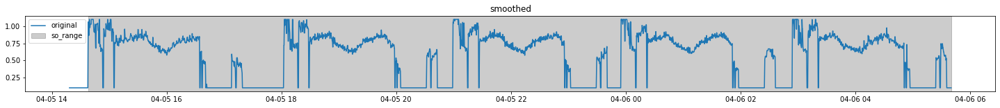

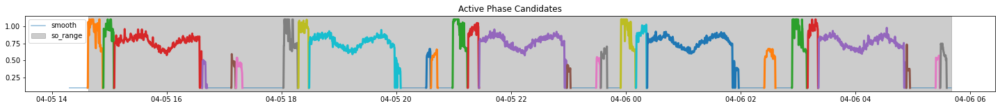

In [276]:
# index_, plotting, company = 0, True, 'yg'
plotting, company = True, 'yg'
config.plot = plotting
config.company = company

for idx_, so_ in so_df_[1:].iterrows():
    
    ######################
    ### read parameter ###
    ######################

    order_number_, gop_, material_, quantity_, so_time_ = so_.so, so_.gop, so_.material, int(so_.qty), so_.total_runtime
    parameter, gap, threshold, min_threshold, smooth_factor, step, upper_limit, mac_main, window, max_cycle, idle_value = params(machine)

    print(f'''
    {'='*100}
    index: {idx_},\t{order_number_}\t{gop_}\t{material_}\t{quantity_}      {so_.start_time} ~ {so_.stop_time}
    {'='*100}
    ''')

    # exchange padded time
    so_range = [so_.start_time, so_.stop_time]
    padded_time = so_time_*0.2 if ((so_time_ / quantity_) >= 1) or (quantity_ > 1) else so_time_*0.5

    ########################
    ### define timeRange ###
    ########################

    timeWindowRedefine = False
    while True:
        patterns, candidates, pattern_index, start_time, _, lll, _ = pattern_history_parse(machine, order_number_)
        # print(patterns)
        if timeWindowRedefine == False: pass
        else:
            print(f"Current time window of interest: {str(so_range[0])} ~ {str(so_range[1])}")
            time.sleep(1)
            start_ = input("Proposed new SO start datetime (format: YYYY-MM-DD HH:MM:SS): ")
            stop_ = input("Proposed new SO stop datetime (format: YYYY-MM-DD HH:MM:SS): ")
            so_range = [pd.to_datetime(start_), pd.to_datetime(stop_)]
            
        padded_range = [so_range[0] - dt.timedelta(hours=padded_time), so_range[1] + dt.timedelta(hours=padded_time)]
        plot_start_time = str(padded_range[0])
        plot_stop_time = str(stop_times[idx_+1]).replace("T", " ")[:19] if stop_times[idx_+1:idx_+2] and so_.stop_time not in stop_times[idx_+1:] else str(padded_range[1])
        period_ = fr.utils.Period([plot_start_time, plot_stop_time])

        row = WebSQL.get_data(mac=mac_main, period=period_.utc)
        data_ = fr.processor.preprocess(row)
        # data_ = signal_preprocessing(data_)
        next_data, current_data = data_[data_.timestamp > so_range[1]], data_[data_.timestamp <= so_range[1]]

        fig = go.Figure()
        fig.add_trace(go.Scatter(x=next_data.timestamp, y=next_data.value, mode='lines', line=dict(width=2, color='#1f77b4'), opacity=0.4, name='next SO', showlegend=True))
        fig.add_trace(go.Scatter(x=current_data.timestamp, y=current_data.value, mode='lines', line=dict(width=3, color='#1f77b4'), opacity=1.0, name='current data', showlegend=True))
        fig.add_vrect(x0=str(so_range[0]), x1=str(so_range[1]), opacity=0.2, fillcolor='black')
        fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=True)
        fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
        fig.update_layout(autosize=False, plot_bgcolor='white', width=1500, height=300, margin=dict(l=5,r=5,b=10,t=10,pad=2), legend=dict(orientation='h', yanchor='bottom', y=1.04, xanchor='left', x=0))
        fig.show()
        time.sleep(2)

        proceed = input("Do we need to change time window to detect at least one complete cycle? (Y/N): ")
        if proceed == "N":
            break
        timeWindowRedefine = True

    # temp dataRange, [padded_range[0], so_range[1]]
    # temp = data_[(data_.timestamp > plot_start_time) & (data_.timestamp <= so_range[1])]
    temp = data_[(data_.timestamp > so_range[0] - dt.timedelta(minutes=20)) & (data_.timestamp <= so_range[1])]
    
    # cleaning + smoothing + inactive phase detection
    times_, y_ = cleaning(temp, smooth_factor, min_threshold)
    smooth_ = smoothing(y_, step)
    times, ss, inactive_cycles_ = inactive_phase_cleaning_normalization(smooth_, times_, upper_limit, window, so_range)

    # active phase detection
    cycles_ = active_phase(ss, times, threshold, upper_limit, max_cycle * 60, gap, idle_value)
    cycles = cycle_generate(cycles_, times, ss, inactive_cycles_, so_range)

    ###############################
    ### define machineParameter ###
    ###############################

    parameterRedefine = False
    while True:
        if parameterRedefine == False: pass
        else:
            times, ss, cycles = params_redefine(temp, machine, so_range)
            parameter, gap, threshold, min_threshold, smooth_factor, step, upper_limit, mac_main, window, max_cycle, idle_value = params(machine)
            print('Parameter Redefine')
        
        active_phase_idx = 0
        fig = go.Figure()
        fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=ss, mode='lines', opacity=0.3, name='smooth', showlegend=False))
        for _, c in enumerate(cycles):
            xx, yy = pd.to_datetime([aa[0] for aa in c]), [aa[1] for aa in c]
            center_idx, max_yy = int(len(xx)//2), max(yy)
            fig.add_trace(go.Scatter(x=xx, y=yy, mode='lines', name=f'{active_phase_idx}', line=dict(width=3)))
            fig.add_trace(go.Scatter(x=[xx[center_idx]], y=[max_yy*1.1], mode='markers+text', text=f'{active_phase_idx}',
                            textposition='middle center', textfont=dict(family='bold', color='black'),
                            marker=dict(color='gray',opacity=0.2,size=15, line=dict(color='black', width=2)), showlegend=False))
            active_phase_idx += 1
        fig.add_vrect(x0=str(so_range[0]), x1=str(so_range[1]), opacity=0.2, fillcolor='black')
        fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=True)
        fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
        fig.update_layout(autosize=False, plot_bgcolor='white', width=1500, height=250, margin=dict(l=5,r=5,b=10,t=10,pad=2))
        fig.show()
        time.sleep(2)
        
        proceed = input("Do we need to change parameter to detect at least one complete cycle? (Y/N): ")
        if proceed == "N":
            break
        parameterRedefine = True

    # cycle parameter
    cycle_parameter = parameter[machine]['cycle']
    # cycle_parameter['L'] = 500 if cycle_parameter['lower_limit'] <= 100 else 1000
    cycle_parameter['L'] = 500 if cycle_parameter['lower_limit'] <= 100 and machine not in ['SNK RB-200F(2060)'] else 1000
    cycle_parameter['min_dist'] = round(max(cycle_parameter['lower_limit'] ** 0.4, 2.8), 1) * 1.3
    cycle_parameter['order'] = int(min(max(cycle_parameter['lower_limit'] ** 0.6, 5), 15))
    cycle_parameter['gap'] = 50
    cycle_parameter['n'] = 5
    cycle_parameter['cycle_gap'] = [30, 60][machine not in {"G3020 #1"}]

    # ###########################
    # ### detect machineCycle ###
    # ###########################
    
    # # quantity_ 장비마다 스핀들 배수 적용
    # quantity_ = quantityRedefine(machine, quantity_)

    # # order_number 미사용
    # patterns, candidates, first_phase, last_phase = pattern_detector(cycles, cycle_parameter, machine, order_number_)
    # output, complete_cycle = best_cycle(patterns, quantity_)

    # output, patterns, candidates, machine, complete_cycle, first_phase, last_phase, flag = so_pattern_output(output, patterns, candidates, machine, complete_cycle, times, ss, cycles, first_phase, last_phase,  material_, order_number_, cycle_parameter)
    
    # # if the flag is True (pattern was found manually, let's revise the parameter file
    # if flag and output != []:
    #     timeInterval = [patterns[i][0]//60 for i in output]
    #     if max(timeInterval) > cycle_parameter['upper_limit']:
    #         cycle_parameter['upper_limit'] = int(max(timeInterval) * 1.1)
    #     if min(timeInterval) < cycle_parameter['lower_limit']:
    #         cycle_parameter['lower_limit'] = int(min(timeInterval) * 0.9)
    #     parameter[machine]['cycle'] = cycle_parameter
    #     print("Updating the parameter with the latest information")
    #     with open('./parameter/equipment_properties.json', 'w') as fout:
    #         json.dump(parameter, fout)
    
    # print(output, complete_cycle)
    # # # only if we have valid cycle output; otherwise, this step is not necessary
    # if output != [] and complete_cycle != []:
    #     store_cycle_output_and_plot(output, patterns, candidates, machine, complete_cycle, times, ss, cycles, first_phase, last_phase, material_, order_number_, store=False)

    # # # cycle summary
    # if complete_cycle != []:
    #     cycle_summary = so_cycle_output(complete_cycle, cycles, cycle_summary, machine, material_, order_number_, gop_)

In [259]:
temp = data_[(data_.timestamp > so_range[0] - dt.timedelta(minutes=20)) & (data_.timestamp <= so_range[1] + dt.timedelta(minutes=10))]
fig = go.Figure()
fig.add_trace(go.Scatter(x=pd.to_datetime(temp.timestamp), y=temp.value, mode='lines', line=dict(width=3, color='#636EFA'), opacity=1, name='original', showlegend=True))
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=False)
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
fig.update_layout(autosize=False, plot_bgcolor='white', width=900, height=300, margin=dict(l=5,r=5,b=10,t=10,pad=2), legend=dict(orientation='h', yanchor='bottom', y=1.04, xanchor='left', x=0))
fig.show()

In [260]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=y_, mode='lines', line=dict(width=5, color='#636EFA'), opacity=0.4, name='original', showlegend=True))
fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=smooth_, mode='lines', line=dict(width=2, color='#636EFA'), opacity=1.0, name='smooth', showlegend=True))
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=False)
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
fig.update_layout(autosize=False, plot_bgcolor='white', width=900, height=300, margin=dict(l=5,r=5,b=10,t=10,pad=2), legend=dict(orientation='h', yanchor='bottom', y=1.04, xanchor='left', x=0))
fig.show()

In [261]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=smooth_, mode='lines', line=dict(width=1, color='#636EFA'), opacity=0.5, name='smooth', showlegend=True))
fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=ss, mode='lines', line=dict(width=3, color='#636EFA'), opacity=1.0, name='normalized', showlegend=True))
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=False)
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
fig.update_layout(autosize=False, plot_bgcolor='white', width=900, height=300, margin=dict(l=5,r=5,b=10,t=10,pad=2), legend=dict(orientation='h', yanchor='bottom', y=1.04, xanchor='left', x=0))
fig.show()

In [262]:
# smooth = ss.copy()
# smooth_d1 = [smooth[i + 1] - smooth[i] for i in range(len(smooth) - 1)] + [0]
# up_threshold, down_threshold, t_diff = np.percentile(smooth_d1, upper_limit), np.percentile(smooth_d1, 100 - upper_limit + 10), 2

In [263]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=smooth_d1, mode='lines', line=dict(width=3, color='#636EFA'), opacity=1, name='diff', showlegend=True))
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=False)
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
fig.update_layout(autosize=False, plot_bgcolor='white', width=900, height=300, margin=dict(l=5,r=5,b=10,t=10,pad=2), legend=dict(orientation='h', yanchor='bottom', y=1.04, xanchor='left', x=0))
fig.show()

In [267]:
# cycles = []
# for i, j in cycles_:
#     temp = []
#     for k in range(i, j + 1):
#         if not any(aa < times[k] < bb for aa, bb in inactive_cycles_):
#             temp += [[times[k], smooth[k], k]]
#         else:  # if any of time is within inactive cycles, let's break!
#             if temp:
#                 cycles += [temp]
#             temp = []
#     if temp:
#         cycles += [temp]

In [24]:
color_lst = ['#636EFA', '#EF553B', '#00CC96', '#AB63FA', '#FFA15A']
color_lst = ['#636EFA', '#EF553B', '#00CC96']
active_phase_idx = 0

fig = go.Figure()
fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=ss, mode='lines', opacity=0.3, name='smooth', showlegend=False))
for idx, c in enumerate(cycles):
    color_idx = idx%len(color_lst)
    xx, yy = pd.to_datetime([aa[0] for aa in c]), [aa[1] for aa in c]
    center_idx, max_yy = int(len(xx)//2), max(yy)
    fig.add_trace(go.Scatter(x=xx, y=yy, mode='lines', line=dict(width=4, color=color_lst[color_idx]), showlegend=False))
    # fig.add_trace(go.Scatter(x=[xx[center_idx]], y=[max_yy*1.1], mode='markers+text', text=f'{active_phase_idx}',
    #                 textposition='middle center', textfont=dict(family='bold', color='black'),
    #                 marker=dict(color='gray',opacity=0.2,size=15, line=dict(color='black', width=2)), showlegend=False))
    active_phase_idx += 1

fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=False)
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
fig.update_layout(autosize=False, plot_bgcolor='white', width=900, height=300, margin=dict(l=5,r=5,b=10,t=10,pad=2))
fig.show()

In [25]:
def plot_complete_cycle(times, ss, complete_cycle):

    ww = sorted([cy for cy in complete_cycle if cy[1] != -1])
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=ss, mode='lines', opacity=0.3, name='smooth', showlegend=False))
    for _, c in enumerate(ww):
        temp1 = sum(cycles[c[0]:c[1] + 1], [])  # concatenate
        xx, yy = pd.to_datetime([xx[0] for xx in temp1]), [xx[1] for xx in temp1]
        fig.add_trace(go.Scatter(x=xx, y=yy, mode='lines', line=dict(width=3), showlegend=False))

    fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=False)
    fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
    fig.update_layout(autosize=False, plot_bgcolor='white', width=1500, height=200, margin=dict(l=5,r=5,b=10,t=10,pad=2))
    fig.show()

In [26]:
def start_phase_matching(index, key, cycles, first_phase, patterns, cycle_parameter):
    exclude = []  # if the time between previous and current active phase is within certain amount time interval, don't consider it as an candidate
    for i in range(index + 1, len(cycles)):
        if (cycles[i][0][0] - cycles[i - 1][-1][0]) / np.timedelta64(1, 's') <= cycle_parameter['cycle_gap']:
            exclude += [i]

    dist_temp = []
    for i in range(index, len(cycles)):
        if i not in exclude:
            x1, x2 = first_phase[key][-1], initial_phase(patterns[key][0], i, cycles)
            # plt.plot(x1)
            # plt.plot(x2)
            init_dist = compare_phase(x1, x2)
            # plt.title(str(index+i) + " " + str(init_dist))
            # plt.show()
            dist_temp += [init_dist]
        else:
            dist_temp += [float('inf')]

    if cycle_parameter['upper_limit'] < 60:
        candidate_point = [i for i in range(len(dist_temp)) if dist_temp[i] <= cycle_parameter['min_dist'] * 2]
    else:
        dist_temp = [float('inf')] + dist_temp + [float('inf')]
        # print(dist_temp)
        candidate_point = []
        for i in range(1, len(dist_temp) - 1):
            if dist_temp[i - 1] > dist_temp[i] and dist_temp[i] < dist_temp[i + 1] and dist_temp[i] <= cycle_parameter['min_dist']:
                candidate_point += [i - 1]
        rest = [i for i in sorted(enumerate(dist_temp[1:-1]), key=lambda x: x[1]) if i[0] not in candidate_point]
        candidate_point += [i for i, _ in rest[:6]]
        # candidate_point += [i for i, _ in rest[:len(cycles)//2 if len(cycles)%2!=1 else len(cycles)//2+1]]
    return [i + index for i in sorted(candidate_point)], dist_temp, rest

In [46]:
patterns, candidates, pattern_index, start_time, first_phase, last_phase, previous_id = pattern_history_parse(machine, order_number_)
m = 10
relaxation_factor = 3

# initialization if the history exists to start
previous_match = {}
for key in list(first_phase.keys())[14:15]:
    previous_match[key], dist, rest = start_phase_matching(0, key, cycles, first_phase, patterns, cycle_parameter)

In [78]:
cycle_parameter['min_dist']

3.6399999999999997

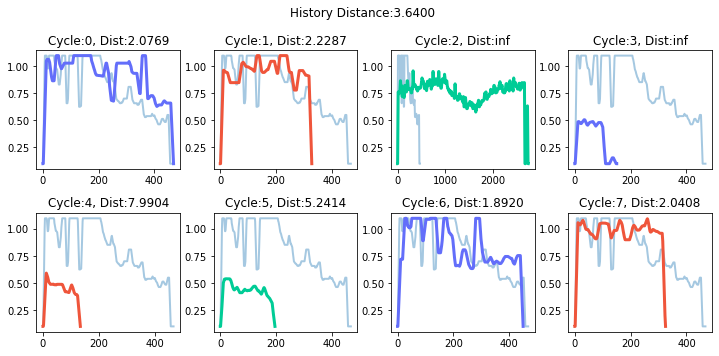

In [80]:
color_lst = ['#636EFA', '#EF553B', '#00CC96']
hist_dist = cycle_parameter['min_dist']

fig, axs = plt.subplots(figsize=(10,5), nrows=2, ncols=4)
for idx, c in enumerate([0,1,2,3,4,5,6,7]):
    row, col, color_idx = idx//4, idx%4, idx%len(color_lst)
    c_, d_ = cycles[c], dist[c]
    xx, yy = pd.to_datetime([aa[0] for aa in c_]), [aa[1] for aa in c_]

    axs[row,col].plot(first_phase[37][0], label='history', linewidth=2, alpha=0.4)
    axs[row,col].plot(yy, label=f'Cycle_{c_}', color=color_lst[color_idx], linewidth=3)
    axs[row,col].set_title(f'Cycle:{c}, Dist:{d_:.4f}')
plt.suptitle(f'History Distance:{hist_dist:.4f}')
plt.tight_layout()

In [29]:
color_lst = ['#636EFA', '#EF553B', '#00CC96']

fig = go.Figure()
fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=ss, mode='lines', opacity=0.3, name='smooth', showlegend=False))
for idx, c in enumerate(previous_match[37]):
    color_idx = idx%len(color_lst)
    c_ = cycles[c]
    xx, yy = pd.to_datetime([aa[0] for aa in c_]), [aa[1] for aa in c_]
    center_idx, max_yy = int(len(xx)//2), max(yy)
    fig.add_trace(go.Scatter(x=xx, y=yy, mode='lines', line=dict(width=4, color=color_lst[color_idx]), showlegend=False))
# fig.add_vrect(x0=str(so_range[0]), x1=str(so_range[1]), opacity=0.2, fillcolor='black')
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=False)
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
fig.update_layout(autosize=False, plot_bgcolor='white', width=900, height=300, margin=dict(l=5,r=5,b=10,t=10,pad=2))
fig.show()

In [140]:
complete_cycle = [(0,4)]
ww = sorted([cy for cy in complete_cycle if cy[1] != -1])
cycle_idx = 0
fig = go.Figure()
# fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=ss, mode='lines', opacity=0.3, name='smooth', showlegend=False))
for _, c in enumerate(ww):
    temp1 = sum(cycles[c[0]:c[1] + 1], [])  # concatenate
    xx, yy = pd.to_datetime([xx[0] for xx in temp1]), [xx[1] for xx in temp1]
    center_idx, max_yy = int(len(xx)//2), max(yy)
    fig.add_trace(go.Scatter(x=xx, y=yy, mode='lines', name=f'{cycle_idx}', line=dict(width=3), showlegend=False))
    # fig.add_trace(go.Scatter(x=[xx[center_idx]], y=[max_yy*1.1], mode='markers+text', text=f'{cycle_idx}',
    #                 textposition='middle center', textfont=dict(family='bold', color='black'),
    #                 marker=dict(color='gray',opacity=0.2,size=15, line=dict(color='black', width=2)), showlegend=False))
    # cycle_idx += 1
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=False)
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
fig.update_layout(autosize=False, plot_bgcolor='white', width=900, height=150, margin=dict(l=5,r=5,b=10,t=10,pad=2))
fig.show()

sm1 = poly_smooth(xx, yy, cycle_parameter)

fig = go.Figure()
fig.add_trace(go.Scatter(x=[idx for idx,_ in enumerate(sm1)], y=sm1, mode='lines', name=f'{cycle_idx}', line=dict(width=3), showlegend=False))
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=False)
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
fig.update_layout(autosize=False, plot_bgcolor='white', width=900, height=150, margin=dict(l=5,r=5,b=10,t=10,pad=2))
fig.show()

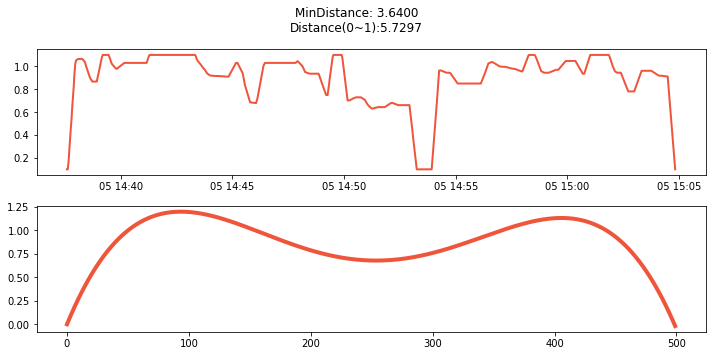

In [186]:
patterns, candidates, pattern_index, start_time, first_phase, last_phase, previous_id = pattern_history_parse(machine, order_number_)
complete_cycle = [(0,1)]
# i_ = 
ww = sorted([cy for cy in complete_cycle if cy[1] != -1])
sm2 = candidates[key][[-1, -2][i_[-1][0] == i]]

cycle_dist = cycle_parameter['min_dist']

fig, axs = plt.subplots(figsize=(10,5), nrows=2)

for _, c in enumerate(ww):
    temp1 = sum(cycles[c[0]:c[1] + 1], [])  # concatenate
    xx, yy = pd.to_datetime([xx[0] for xx in temp1]), [xx[1] for xx in temp1]
    axs[0].plot(xx, yy, color='#EF553B', linewidth=2, alpha=1, label='')
    

sm1 = poly_smooth(xx, yy, cycle_parameter)
dist = compute_euclidean(sm1, sm2)

axs[1].plot(sm1, color='#EF553B', linewidth=4)

plt.suptitle(f'MinDistance: {cycle_dist:.4f}\nDistance({complete_cycle[0][0]}~{complete_cycle[0][1]}):{dist:.4f}')
plt.tight_layout()


# fig = go.Figure()
# fig.add_trace(go.Scatter(x=[idx for idx,_ in enumerate(sm1)], y=sm1, mode='lines', name=f'{cycle_idx}', line=dict(width=3), showlegend=False))
# fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=False)
# fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
# fig.update_layout(autosize=False, plot_bgcolor='white', width=900, height=150, margin=dict(l=5,r=5,b=10,t=10,pad=2))
# fig.show()

[(-5, -1)]
0 4 [(-5, -1)]
0 5 [(-5, -1), (0, 4)]
6 4 [(-5, -1), (0, 5)]
11 5 [(-5, -1), (0, 5), (6, 10)]
17 3 [(-5, -1), (0, 5), (6, 10), (11, 16)]
21 3 [(-5, -1), (0, 5), (6, 10), (11, 16), (17, 20)]
21 5 [(-5, -1), (0, 5), (6, 10), (11, 16), (17, 20), (21, 24)]


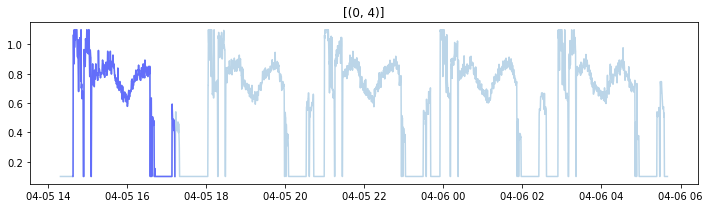

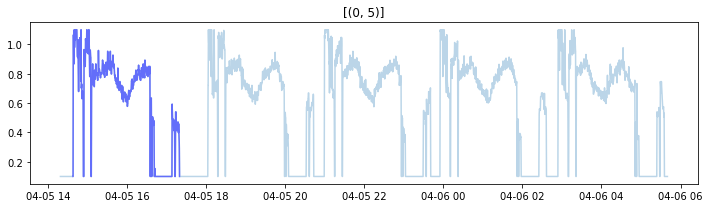

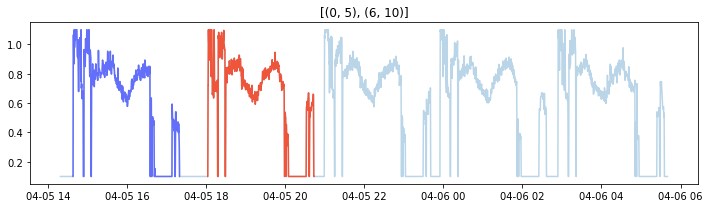

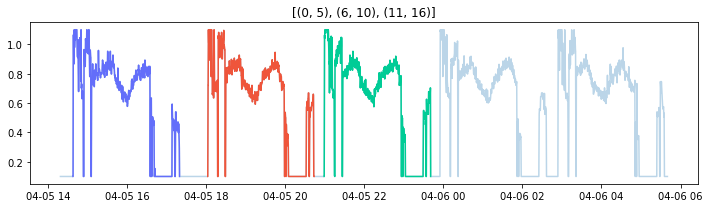

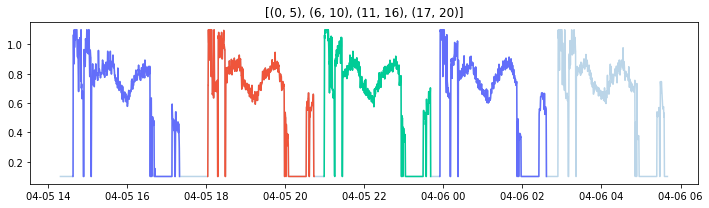

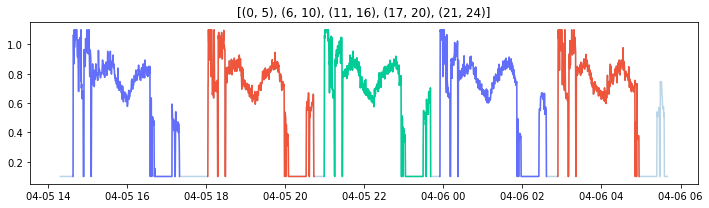

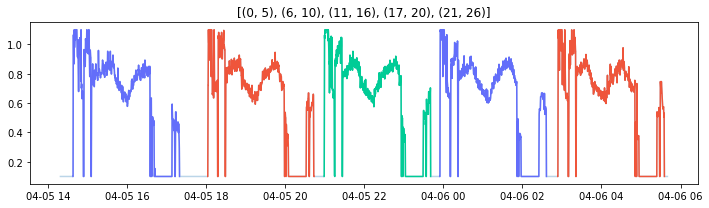

In [375]:
color_lst = ['#636EFA', '#EF553B', '#00CC96']
patterns, candidates, pattern_index, start_time, first_phase, last_phase, previous_id = pattern_history_parse(machine, order_number_)
m = 10
relaxation_factor = 3

# initialization if the history exists to start
previous_match = {}
for key in list(first_phase.keys())[14:15]:
    previous_match[key], dist, rest = start_phase_matching(0, key, cycles, first_phase, patterns, cycle_parameter)

patterns_ = dict()
patterns_[37] = patterns[37]
print(patterns_[37][2])

for i in range(len(cycles)):
    timelapse, xx, yy = 0, [], []
    for k in range(cycle_parameter['gap']):
        if i + k < len(cycles) and (k > 0 and (cycles[i + k][0][0] - cycles[i + k - 1][-1][0]) / np.timedelta64(1, 's') >= (cycle_parameter['lower_limit'] + cycle_parameter['upper_limit']) * 30 * m):
            break
        if i + k < len(cycles) and (k == 0 or (k > 0 and (cycles[i + k][0][0] - cycles[i + k - 1][-1][0]) / np.timedelta64(1, 's') < (cycle_parameter['lower_limit'] + cycle_parameter['upper_limit']) * 30 * m)):
            current = cycles[i + k]
            timelapse += time_diff_calculator(i + k, cycles)
            xx += [x_[0] for x_ in current]
            yy += [x_[1] for x_ in current]
            if cycle_parameter['lower_limit'] * 60 <= timelapse <= cycle_parameter['upper_limit'] * 60:
                try:
                    sm1 = poly_smooth(xx, yy, cycle_parameter)  # polyfit
                except:
                    print('not available', i, i + k)
                    sm1 = []

                notFound = True
                for key in patterns_.keys():
                    timelapse_, score_, i_, tt, _ = patterns_[key]
                    # print(key, previous_match[key])
                    include = (i in previous_match[key] or cycle_parameter['lower_limit'] <= 30)
                    # print(key, i, i+k, previous_match[key], timelapse, timelapse_, len(sm1), include, len(i_) > 1 or (len(i_) == 1 and i_[-1][1] < i))
                    if 1 - (cycle_parameter['tolerance'] / 100) <= min(timelapse, timelapse_) / max(timelapse, timelapse_) and (len(i_) > 1 or (len(i_) == 1 and i_[-1][1] < i)) and sm1 != [] and include:
                        sm2 = candidates[key][[-1, -2][i_[-1][0] == i]]
                        dist = compute_euclidean(sm1, sm2)
                        initial_ = initial_phase(timelapse, i, cycles)
                        last_ = end_phase(timelapse_, i, i + k, cycles, len(last_phase[key][-1]))

                        # 마지막 지점 다음 지점이 시작점이거나 or 끝지점이어야한다
                        if dist <= cycle_parameter['min_dist'] and (i+k == len(cycles)-1 or (i+k+1 < len(cycles) and i+k+1 in previous_match[key])) or config.company in {'jm'}:
                            case_ = (cycle_parameter['upper_limit'] < 20 and i > i_[-1][1]) or (cycle_parameter['upper_limit'] >= 20 and i >= i_[-1][1])
                            if case_ and (i - i_[-1][1] < cycle_parameter['upper_gap'] or i_[-1][1] == -1) and ((i_[-1][0] == i_[-1][1] and i_[-1][1] < i) or i_[-1][1] < i):  # no overlapping
                                
                                print(i, k, patterns_[37][2])

                                patterns_[key][1] += [dist]
                                patterns_[key][2] += [(i, i + k)]
                                patterns_[key][3] += [timelapse]
                                patterns_[key][4] += [k + [0, 1][i != i_[-1][1]]]
                                patterns_[key][0] = np.mean(patterns_[key][3][:-1])
                                candidates[key] += [sm1]
                                first_phase[key] += [initial_]
                                last_phase[key] += [last_]
                                notFound = False
                                
                                ww = sorted([cy for cy in patterns[37][2] if cy[1] != -1])
                                plt.figure(figsize=(10,3))
                                plt.plot(times, ss, alpha=0.3)
                                for idx, c in enumerate(ww):
                                    temp1 = sum(cycles[c[0]:c[1] + 1], [])  # concatenate
                                    xx_, yy_ = pd.to_datetime([x[0] for x in temp1]), [x[1] for x in temp1]
                                    plt.plot(xx_, yy_, color=color_lst[idx%len(color_lst)])
                                plt.title(f'{ww}')
                                plt.tight_layout()

                                # fig = go.Figure()
                                # fig.add_trace(go.Scatter(x=pd.to_datetime(times), y=ss, mode='lines', opacity=0.2, name='smooth', showlegend=False))
                                # for idx, c in enumerate(ww):
                                #     temp1 = sum(cycles[c[0]:c[1] + 1], [])  # concatenate
                                #     xx, yy = pd.to_datetime([xx[0] for xx in temp1]), [xx[1] for xx in temp1]
                                    
                                #     fig.add_trace(go.Scatter(x=xx, y=yy, mode='lines', line=dict(width=3)))

                                # fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=True)
                                # fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
                                # fig.update_layout(autosize=False, plot_bgcolor='white', width=1500, height=200, margin=dict(l=5,r=5,b=10,t=10,pad=2))
                                # fig.show()

                            elif i <= i_[-1][1] and score_ != [] and i_[-1][0] == i:  # overlapping, so let's choose the better one
                                last_1 = np.median([compare_phase(last_phase[key][ll], last_phase[key][-1], 'last') for ll in range(len(last_phase[key]) - 1)])
                                last_2 = np.median([compare_phase(last_phase[key][ll], last_, 'last') for ll in range(len(last_phase[key]) - 1)])
                                last_history = [last_phase[key][ll] for ll in range(len(last_phase[key]) - 1)]

                                
                                if last_2 < last_1:
                                
                                    print(i, k, patterns_[37][2])

                                    patterns_[key][1][-1] = dist
                                    patterns_[key][2][-1] = (i, i + k)
                                    patterns_[key][3][-1] = timelapse
                                    patterns_[key][4][-1] = k + [0, 1][i != i_[-2][1]]
                                    patterns_[key][0] = np.mean(patterns_[key][3][:-1])
                                    candidates[key][-1] = sm1
                                    last_phase[key][-1] = last_
                                    notFound = False
                                    
                                    ww = sorted([cy for cy in patterns[37][2] if cy[1] != -1])
                                    plt.figure(figsize=(10,3))
                                    plt.plot(times, ss, alpha=0.3)
                                    for idx, c in enumerate(ww):
                                        temp1 = sum(cycles[c[0]:c[1] + 1], [])  # concatenate
                                        xx_, yy_ = pd.to_datetime([x[0] for x in temp1]), [x[1] for x in temp1]
                                        plt.plot(xx_, yy_, color=color_lst[idx%len(color_lst)])
                                    plt.title(f'{ww}')
                                    plt.tight_layout()
                                    
            elif timelapse > cycle_parameter['upper_limit'] * 60:
                break


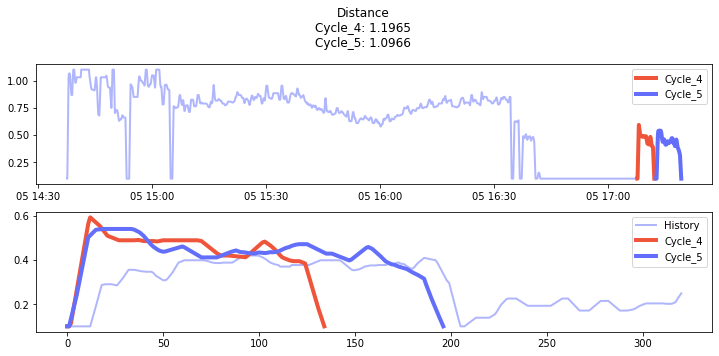

In [258]:
color_lst = ['#EF553B', '#636EFA']
patterns, candidates, pattern_index, start_time, first_phase, last_phase, previous_id = pattern_history_parse(machine, order_number_)
complete_cycle = [(0,5)]
ww = sorted([cy for cy in complete_cycle if cy[1] != -1])

cycle_dist = cycle_parameter['min_dist']

fig, axs = plt.subplots(figsize=(10,5), nrows=2)

for _, c in enumerate(ww):
    temp1 = sum(cycles[c[0]:c[1] + 1], [])  # concatenate
    xx, yy = pd.to_datetime([xx[0] for xx in temp1]), [xx[1] for xx in temp1]
    axs[0].plot(xx, yy, color='#636EFA', linewidth=2, alpha=0.5)

for idx, c in enumerate([4,5]):
    color_idx = idx%len(color_lst)
    c_ = cycles[c]
    xx_, yy_ = pd.to_datetime([aa[0] for aa in c_]), [aa[1] for aa in c_]
    axs[0].plot(xx_,yy_, color=color_lst[color_idx], linewidth=4, label=f'Cycle_{c}')
axs[0].legend(loc='upper right')
    # fig.add_trace(go.Scatter(x=xx, y=yy, mode='lines', line=dict(width=4, color=color_lst[color_idx]), showlegend=False))

end_dist = []
axs[1].plot(last_phase[37][0], color='#636EFA', linewidth=2, alpha=0.5, label='History')
for idx, c in enumerate([4,5]):
    color_idx = idx%len(color_lst)
    c_ = cycles[c]
    xx_, yy_ = pd.to_datetime([aa[0] for aa in c_]), [aa[1] for aa in c_]
    dist_ = compare_phase(last_phase[37][0], yy_)
    end_dist.append(dist_)
    axs[1].plot(yy_, color=color_lst[color_idx], linewidth=4, label=f'Cycle_{c}')

axs[1].legend(loc='upper right')
# axs[1].set_title(f'Cycle_4:{end_dist[0]:.4f}\nCycle_5:{end_dist[1]:.4f}')
plt.suptitle(f'Distance\nCycle_4: {end_dist[0]:.4f}\nCycle_5: {end_dist[1]:.4f}')
plt.tight_layout()


# fig = go.Figure()
# fig.add_trace(go.Scatter(x=[idx for idx,_ in enumerate(sm1)], y=sm1, mode='lines', name=f'{cycle_idx}', line=dict(width=3), showlegend=False))
# fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=False)
# fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
# fig.update_layout(autosize=False, plot_bgcolor='white', width=900, height=150, margin=dict(l=5,r=5,b=10,t=10,pad=2))
# fig.show()

In [278]:
complete_cycle = patterns[37][2]
complete_cycle

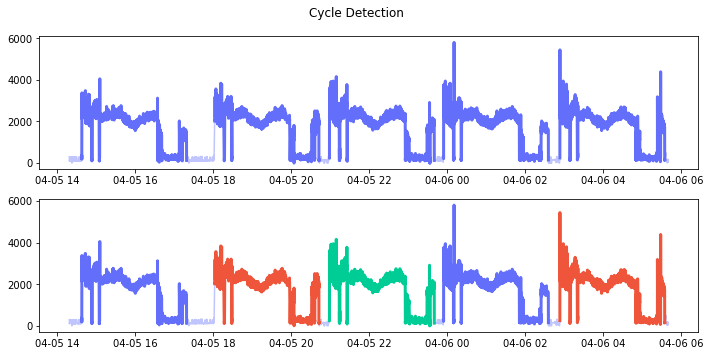

In [306]:
color_lst = ['#636EFA', '#EF553B', '#00CC96']
ww = sorted([cy for cy in complete_cycle if cy[1] != -1])
# cycle_idx = 0

fig, axs = plt.subplots(figsize=(10,5), nrows=2)

axs[0].plot(temp.timestamp, temp.value, alpha=0.4, color='#636EFA')
for idx, c in enumerate(ww):
    temp1 = temp[(temp.timestamp >= pd.to_datetime(cycles[c[0]][0][0])) & (temp.timestamp < pd.to_datetime(cycles[c[1]][-1][0]))][['timestamp', 'value']]
    axs[0].plot(temp1.timestamp, temp1.value, color='#636EFA', linewidth=3)

axs[1].plot(temp.timestamp, temp.value, alpha=0.4, color='#636EFA')
for idx, c in enumerate(ww):
    temp1 = temp[(temp.timestamp >= pd.to_datetime(cycles[c[0]][0][0])) & (temp.timestamp < pd.to_datetime(cycles[c[1]][-1][0]))][['timestamp', 'value']]
    axs[1].plot(temp1.timestamp, temp1.value, color=color_lst[idx%len(color_lst)], linewidth=3)

plt.suptitle('Cycle Detection')
plt.tight_layout()
# fig = go.Figure()
# fig.add_trace(go.Scatter(x=pd.to_datetime(temp.timestamp), y=temp.value, mode='lines', opacity=0.3, showlegend=False))
# for _, c in enumerate(ww):
#     temp1 = temp[(temp.timestamp >= pd.to_datetime(cycles[c[0]][0][0])) & (temp.timestamp < pd.to_datetime(cycles[c[1]][-1][0]))][['timestamp', 'value']]
#     # temp1 = sum(cycles[c[0]:c[1] + 1], [])  # concatenate
#     # xx, yy = pd.to_datetime([xx[0] for xx in temp1]), [xx[1] for xx in temp1]
#     # center_idx, max_yy = int(len(xx)//2), max(yy)
#     fig.add_trace(go.Scatter(x=temp1.timestamp, y=temp1.value, mode='lines', name=f'{cycle_idx}', line=dict(width=3)))
#     # fig.add_trace(go.Scatter(x=[xx[center_idx]], y=[max_yy*1.1], mode='markers+text', text=f'{cycle_idx}',
#     #                 textposition='middle center', textfont=dict(family='bold', color='black'),
#     #                 marker=dict(color='gray',opacity=0.2,size=15, line=dict(color='black', width=2)), showlegend=False))
#     # cycle_idx += 1
# fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False, rangeslider_visible=True)
# fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True, showgrid=False)
# fig.update_layout(autosize=False, plot_bgcolor='white', width=1500, height=200, margin=dict(l=5,r=5,b=10,t=10,pad=2))
# fig.show()

In [342]:
color_lst = ['#636EFA', '#EF553B', '#00CC96']
ww_ = [sorted([cy for cy in complete_cycle if cy[1] != -1])[0]]
# cycle_idx = 0

for idx, c in enumerate(ww_):
    temp1 = temp[(temp.timestamp >= pd.to_datetime(cycles[c[0]][0][0])) & (temp.timestamp < pd.to_datetime(cycles[c[1]][-1][0]))][['timestamp', 'value']]

In [337]:
for _, c in enumerate([(0,5)]):
    temp1 = sum(cycles[c[0]:c[1] + 1], [])  # concatenate
    xx_, yy_ = pd.to_datetime([xx[0] for xx in temp1]), [xx[1] for xx in temp1]
sm1 = poly_smooth(xx, yy, cycle_parameter)  # polyfit

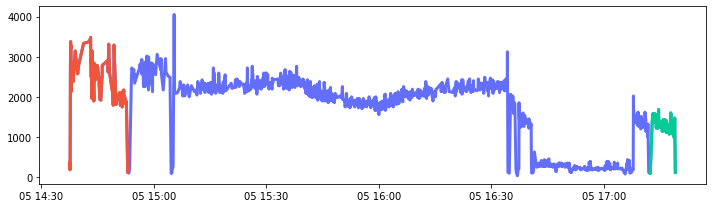

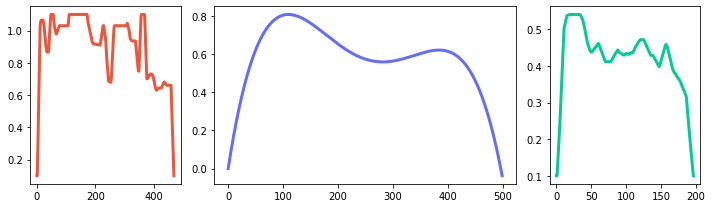

In [364]:
from matplotlib import gridspec
# fig, axs = plt.subplots(figsize=(10,5), nrows=2)
plt.figure(figsize=(10,3))
plt.plot(temp1.timestamp, temp1.value, color='#636EFA', linewidth=3, alpha=1)

start = temp1[(temp1.timestamp >= cycles[0][0][0]) & (temp1.timestamp < cycles[0][-1][0])]
plt.plot(start.timestamp, start.value, linewidth=3, color='#EF553B')

end = temp1[(temp1.timestamp >= pd.to_datetime(cycles[5][0][0]) -dt.timedelta(minutes=0.4)) & (temp1.timestamp < cycles[5][-1][0])]
plt.plot(end.timestamp, end.value, linewidth=3, color='#00CC96')

plt.tight_layout()
fig = plt.figure(figsize=(10,3))
spec = gridspec.GridSpec(ncols=3, nrows=1, width_ratios=[1,2,1])

ax0 = fig.add_subplot(spec[0])
ax1 = fig.add_subplot(spec[1])
ax2 = fig.add_subplot(spec[2])

ax0.plot([c for _,c,_ in cycles[0]], linewidth=3, color='#EF553B')

ax1.plot(sm1, linewidth=3, color='#636EFA')

ax2.plot([c for _,c,_ in cycles[5]], linewidth=3, color='#00CC96')

fig.tight_layout()
# fig, axs = plt.subplots(figsize=(10,3), ncols=3)


plt.tight_layout()

In [ ]:
fig, axs = plt.subplots(figsize=(10,5), nrows=2)



for _, c in enumerate(ww):
    temp1 = sum(cycles[c[0]:c[1] + 1], [])  # concatenate
    xx, yy = pd.to_datetime([xx[0] for xx in temp1]), [xx[1] for xx in temp1]
    axs[0].plot(xx, yy, color='#636EFA', linewidth=2, alpha=0.5)

for idx, c in enumerate([4,5]):
    color_idx = idx%len(color_lst)
    c_ = cycles[c]
    xx_, yy_ = pd.to_datetime([aa[0] for aa in c_]), [aa[1] for aa in c_]
    axs[0].plot(xx_,yy_, color=color_lst[color_idx], linewidth=4, label=f'Cycle_{c}')
axs[0].legend(loc='upper right')
    # fig.add_trace(go.Scatter(x=xx, y=yy, mode='lines', line=dict(width=4, color=color_lst[color_idx]), showlegend=False))


In [202]:
last_1_

[[0.1,
  0.1,
  0.1,
  0.1,
  0.1,
  0.1,
  0.1,
  0.1,
  0.1,
  0.1,
  0.1,
  0.1,
  0.1,
  0.12995910034978692,
  0.15991820069957396,
  0.19167484707034826,
  0.22343149344112254,
  0.2551881398118968,
  0.28694478618267105,
  0.2887423322036583,
  0.29053987822464555,
  0.29053987822464555,
  0.29053987822464555,
  0.29053987822464555,
  0.2887423322036583,
  0.28694478618267105,
  0.2851472401616839,
  0.29601811371717807,
  0.30688898727267216,
  0.3177598608281664,
  0.3304282804046478,
  0.34309669998112907,
  0.35576511955761037,
  0.35576511955761037,
  0.35576511955761037,
  0.35576511955761037,
  0.3539675735366232,
  0.352170027515636,
  0.3503724814946487,
  0.3485749354736616,
  0.3485749354736616,
  0.34677738945267433,
  0.34677738945267433,
  0.3467773894526743,
  0.34677738945267433,
  0.3412991539601419,
  0.3304282804046478,
  0.3249500449121152,
  0.3194718094195827,
  0.3139935739270503,
  0.30851533843451784,
  0.30851533843451784,
  0.31211043047649223,
  0.322

In [84]:
patterns_

{37: [8003.898116666666,
  [nan,
   1.8400788110093829,
   0.4823097072814042,
   0.1820687134592586,
   0.1300377189023968,
   0.19577720971164003],
  [(-5, -1), (0, 5), (6, 10), (11, 16), (17, 20), (21, 26)],
  [7929.401583333333,
   8054.532,
   7990.4839999999995,
   8006.372,
   8038.701,
   7972.9580000000005],
  [15, 6, 5, 6, 4, 6]]}